<a href="https://www.kaggle.com/code/kalilurrahman/nfl-data-bowl-2021-special-teams-eda?scriptVersionId=176180841" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/nfl-big-data-bowl-2022/players.csv
/kaggle/input/nfl-big-data-bowl-2022/PFFScoutingData.csv
/kaggle/input/nfl-big-data-bowl-2022/tracking2019.csv
/kaggle/input/nfl-big-data-bowl-2022/tracking2020.csv
/kaggle/input/nfl-big-data-bowl-2022/games.csv
/kaggle/input/nfl-big-data-bowl-2022/tracking2018.csv
/kaggle/input/nfl-big-data-bowl-2022/plays.csv


In [2]:
!wget http://bit.ly/3ZLyF82 -O CSS.css -q
    
from IPython.core.display import HTML
with open('./CSS.css', 'r') as file:
    custom_css = file.read()

HTML(custom_css)

In [3]:
%matplotlib inline
from IPython.core.display import display, HTML, Javascript

html_contents ="""
<!DOCTYPE html>
<html lang="en">
    <head>
        <link rel="stylesheet" href="https://www.w3schools.com/w3css/4/w3.css">
        <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Raleway">
        <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Roboto">
        <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Verdana">
        <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Open Sans">
        <link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/4.7.0/css/font-awesome.min.css">
        <style>
        .title-section{
            font-family: "Roboto", Verdana, sans-serif;
            font-weight: bold;
            color: "#6A8CAF";
            letter-spacing: 6px;
        }
        hr { border: 1px solid #E58F65 !important;
             color: #E58F65 !important;
             background: #E58F65 !important;
           }
        body {
            font-family: "Verdana", sans-serif;
            }        
        </style>
    </head>    
</html>
"""

HTML(html_contents)



# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">0.NFL - National Football League - An Introduction </span>


| NFL Logo | NFL Team Locations |
| :---: | :-----: |
| ![NFL](https://upload.wikimedia.org/wikipedia/en/thumb/a/a2/National_Football_League_logo.svg/188px-National_Football_League_logo.svg.png) |   ![NFL Teams](https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/US_National_Football_League_Teams_Location-en.svg/500px-US_National_Football_League_Teams_Location-en.svg.png)   |





###### Some Info from Wikipedia
###### The National Football League (NFL) is a professional American football league consisting of 32 teams, divided equally between the National Football Conference (NFC) and the American Football Conference (AFC). The NFL is one of the four major North American professional sports leagues, the highest professional level of American football in the world.

###### The NFL's eighteen-week regular season runs from early September to early January, with each team playing seventeen games and having one bye week. Following the conclusion of the regular season, seven teams from each conference (four division winners and three wild card teams) advance to the playoffs, a single-elimination tournament culminating in the Super Bowl, which is usually held on the first Sunday in February and is played between the champions of the NFC and AFC. The league is headquartered in New York City.

###### The NFL was formed in 1920 as the American Professional Football Association (APFA) before renaming itself the National Football League for the 1922 season. After initially determining champions through end-of-season standings, a playoff system was implemented in 1933 that culminated with the NFL Championship Game until 1966. Following an agreement to merge the NFL with the rival American Football League (AFL), the Super Bowl was first held in 1967 to determine a champion between the best teams from the two leagues and has remained as the final game of each NFL season since the merger was completed in 1970.

###### Today,the NFL has the highest average attendance (67,591) of any professional sports league in the world and is the most popular sports league in the United States. The Super Bowl is also among the biggest club sporting events in the world, with the individual games accounting for many of the most watched television programs in American history and all occupying the Nielsen's Top 5 tally of the all-time most watched U.S. television broadcasts by 2015. The NFL is the wealthiest professional sports league by revenue, and the sports league with the most valuable teams.

# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">1.Load the Libraries </span>


In [4]:
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt


In [5]:
plays = '../input/nfl-big-data-bowl-2022/plays.csv'
plays_df = pd.read_csv(plays)

# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">2.Check the Datasets </span>


In [6]:
def disp(data,num):
    print(data.shape)
    print(data.columns)
    print("*"*num)
    print(data.describe())
    print("="*num)
    return data.head(num)

In [7]:
print(disp(plays_df,20))

(19979, 25)
Index(['gameId', 'playId', 'playDescription', 'quarter', 'down', 'yardsToGo',
       'possessionTeam', 'specialTeamsPlayType', 'specialTeamsResult',
       'kickerId', 'returnerId', 'kickBlockerId', 'yardlineSide',
       'yardlineNumber', 'gameClock', 'penaltyCodes', 'penaltyJerseyNumbers',
       'penaltyYards', 'preSnapHomeScore', 'preSnapVisitorScore', 'passResult',
       'kickLength', 'kickReturnYardage', 'playResult',
       'absoluteYardlineNumber'],
      dtype='object')
********************
             gameId        playId       quarter          down     yardsToGo  \
count  1.997900e+04  19979.000000  19979.000000  19979.000000  19979.000000   
mean   2.019114e+09   2037.557886      2.484058      1.707142      3.750288   
std    8.519225e+05   1228.659555      1.109341      1.968283      5.671644   
min    2.018091e+09     35.000000      1.000000      0.000000      0.000000   
25%    2.018120e+09    985.000000      2.000000      0.000000      0.000000   
50%    2

In [8]:
plays_df.fillna(0)

,gameId,playId,playDescription,quarter,down,yardsToGo,possessionTeam,specialTeamsPlayType,specialTeamsResult,kickerId,...,penaltyCodes,penaltyJerseyNumbers,penaltyYards,preSnapHomeScore,preSnapVisitorScore,passResult,kickLength,kickReturnYardage,playResult,absoluteYardlineNumber
0,2018090600,37,J.Elliott kicks 65 yards from PHI 35 to end zo...,1,0,0,PHI,Kickoff,Touchback,44966.0,...,0,0,0.0,0,0,0,66.0,0.0,40,45
1,2018090600,366,"(9:20) C.Johnston punts 56 yards to ATL 36, Ce...",1,4,4,PHI,Punt,Return,45603.0,...,UNSd,PHI 18,-15.0,0,0,0,56.0,5.0,36,18
2,2018090600,658,"(5:03) M.Bryant 21 yard field goal is GOOD, Ce...",1,4,3,ATL,Field Goal,Kick Attempt Good,27091.0,...,0,0,0.0,0,0,0,21.0,0.0,0,13
3,2018090600,677,M.Bosher kicks 64 yards from ATL 35 to PHI 1. ...,1,0,0,ATL,Kickoff,Return,37267.0,...,0,0,0.0,0,3,0,64.0,30.0,34,75
4,2018090600,872,"(:33) C.Johnston punts 65 yards to end zone, C...",1,4,18,PHI,Punt,Touchback,45603.0,...,0,0,0.0,0,3,0,65.0,0.0,45,45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19974,2021010315,3683,J.Myers kicks 65 yards from SEA 35 to end zone...,4,0,0,SEA,Kickoff,Touchback,41175.0,...,0,0,0.0,16,19,0,75.0,0.0,40,75
19975,2021010315,3870,"J.Myers extra point is GOOD, Center-T.Ott, Hol...",4,0,0,SEA,Extra Point,Kick Attempt Good,41175.0,...,0,0,0.0,16,25,0,0.0,0.0,0,25
19976,2021010315,3886,J.Myers kicks 65 yards from SEA 35 to end zone...,4,0,0,SEA,Kickoff,Touchback,41175.0,...,0,0,0.0,16,26,0,75.0,0.0,40,75
19977,2021010315,4166,"T.Vizcaino extra point is GOOD, Center-C.Holba...",4,0,0,SF,Extra Point,Kick Attempt Good,47590.0,...,0,0,0.0,22,26,0,0.0,0.0,0,95


# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">3.Let us do some basic Visualization using Matplotlib and Seaborn </span>


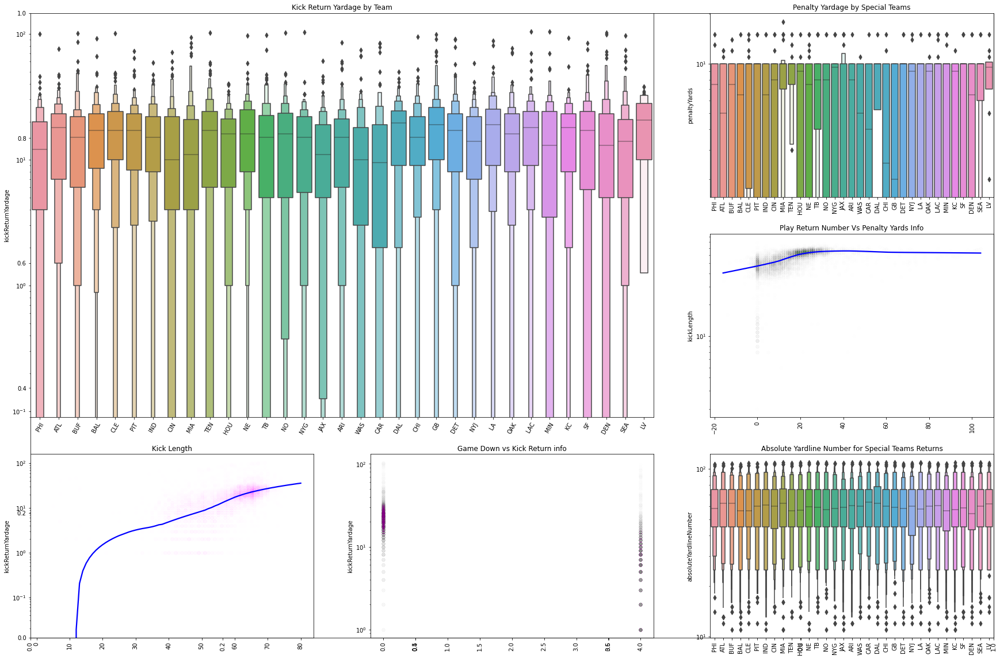

In [9]:

# Import necessary auxiliary stuffs
from matplotlib import gridspec, ticker

# Define size and grid spec
fig = plt.figure(figsize=(30, 20), constrained_layout=False)
gs = gridspec.GridSpec(3, 3, figure=fig)
plt.xticks(rotation=90)

# Make plot to put in first row, rightmost column
ax = fig.add_subplot(gs[1, 2])
sns.regplot(data = plays_df, x = 'kickReturnYardage', y = 'kickLength',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'green'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')

ax.set(title = 'Play Return Number Vs Penalty Yards Info', xlabel = None)

plt.xticks(rotation=90)

# Make plot to put in second row, rightmost column
ax = fig.add_subplot(gs[0, 2])
sns.boxenplot(data = plays_df, x = 'possessionTeam', y = 'penaltyYards', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Penalty Yardage by Special Teams', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, rightmost column
ax = fig.add_subplot(gs[2, 2])
sns.boxenplot(data = plays_df, x = 'possessionTeam', y = 'absoluteYardlineNumber', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Absolute Yardline Number for Special Teams Returns', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, center column
ax = fig.add_subplot(gs[2, 0])
sns.regplot(data = plays_df, y = 'kickReturnYardage', x = 'kickLength',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'magenta'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Kick Length', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, leftmost column
ax = fig.add_subplot(gs[2, 1])
sns.regplot(data = plays_df, x = 'down', y = 'kickReturnYardage',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'purple'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Game Down vs Kick Return info', xlabel = None)
plt.xticks(rotation=90)

# Make plot that spans the remaining grid
ax = fig.add_subplot(gs[0:2, 0:2])
sns.boxenplot(data = plays_df, x = 'possessionTeam', y = 'kickReturnYardage', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Kick Return Yardage by Team', xlabel = None)
plt.xticks(rotation=60)

plt.show()


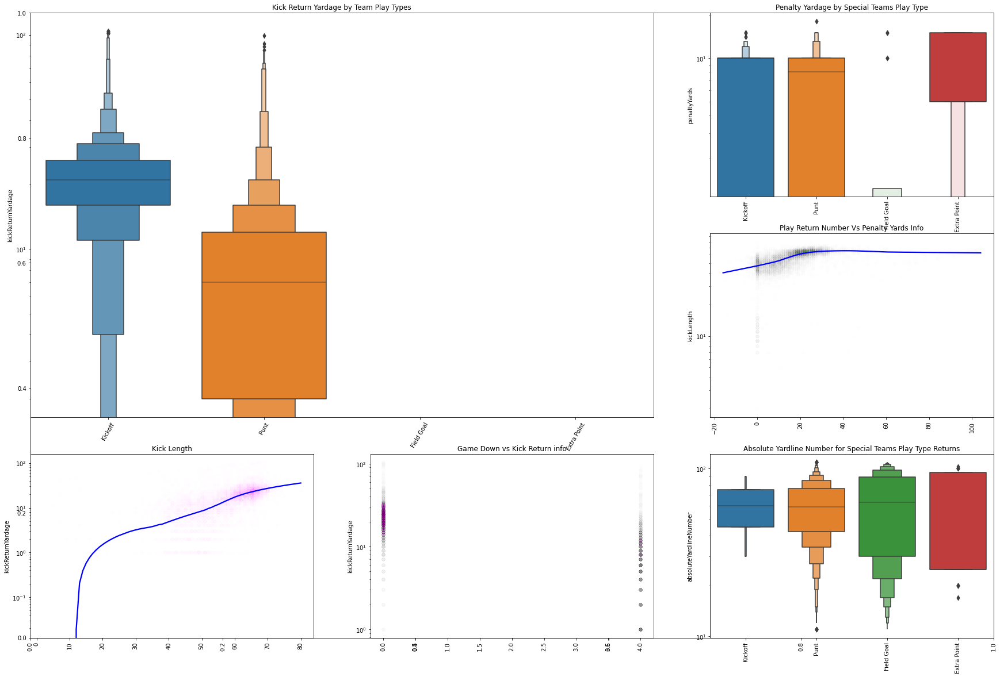

In [10]:

# Import necessary auxiliary stuffs
from matplotlib import gridspec, ticker

# Define size and grid spec
fig = plt.figure(figsize=(30, 20), constrained_layout=False)
gs = gridspec.GridSpec(3, 3, figure=fig)
plt.xticks(rotation=90)

# Make plot to put in first row, rightmost column
ax = fig.add_subplot(gs[1, 2])
sns.regplot(data = plays_df, x = 'kickReturnYardage', y = 'kickLength',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'green'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')

ax.set(title = 'Play Return Number Vs Penalty Yards Info', xlabel = None)

plt.xticks(rotation=90)

# Make plot to put in second row, rightmost column
ax = fig.add_subplot(gs[0, 2])
sns.boxenplot(data = plays_df, x = 'specialTeamsPlayType', y = 'penaltyYards', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Penalty Yardage by Special Teams Play Type', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, rightmost column
ax = fig.add_subplot(gs[2, 2])
sns.boxenplot(data = plays_df, x = 'specialTeamsPlayType', y = 'absoluteYardlineNumber', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Absolute Yardline Number for Special Teams Play Type Returns', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, center column
ax = fig.add_subplot(gs[2, 0])
sns.regplot(data = plays_df, y = 'kickReturnYardage', x = 'kickLength',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'magenta'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Kick Length', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, leftmost column
ax = fig.add_subplot(gs[2, 1])
sns.regplot(data = plays_df, x = 'down', y = 'kickReturnYardage',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'purple'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Game Down vs Kick Return info', xlabel = None)
plt.xticks(rotation=90)

# Make plot that spans the remaining grid
ax = fig.add_subplot(gs[0:2, 0:2])
sns.boxenplot(data = plays_df, x = 'specialTeamsPlayType', y = 'kickReturnYardage', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Kick Return Yardage by Team Play Types', xlabel = None)
plt.xticks(rotation=60)


plt.show()
 

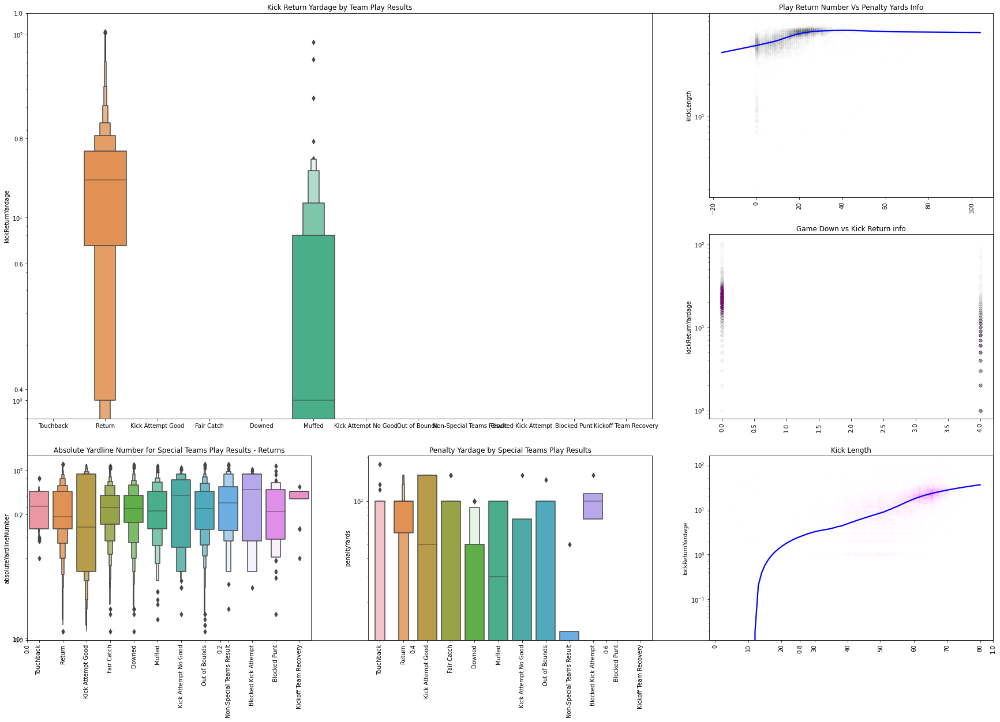

In [11]:

# Import necessary auxiliary stuffs
from matplotlib import gridspec, ticker

# Define size and grid spec
fig = plt.figure(figsize=(30, 20), constrained_layout=False)
gs = gridspec.GridSpec(3, 3, figure=fig)
plt.xticks(rotation=90)

# Make plot to put in first row, rightmost column
ax = fig.add_subplot(gs[0, 2])
sns.regplot(data = plays_df, x = 'kickReturnYardage', y = 'kickLength',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'green'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')

ax.set(title = 'Play Return Number Vs Penalty Yards Info', xlabel = None)

plt.xticks(rotation=90)

# Make plot to put in second row, rightmost column
ax = fig.add_subplot(gs[2, 1])
sns.boxenplot(data = plays_df, x = 'specialTeamsResult', y = 'penaltyYards', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Penalty Yardage by Special Teams Play Results', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, rightmost column
ax = fig.add_subplot(gs[2, 0])
sns.boxenplot(data = plays_df, x = 'specialTeamsResult', y = 'absoluteYardlineNumber', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Absolute Yardline Number for Special Teams Play Results - Returns', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, center column
ax = fig.add_subplot(gs[2, 2])
sns.regplot(data = plays_df, y = 'kickReturnYardage', x = 'kickLength',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'magenta'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Kick Length', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, leftmost column
ax = fig.add_subplot(gs[1, 2])
sns.regplot(data = plays_df, x = 'down', y = 'kickReturnYardage',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'purple'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Game Down vs Kick Return info', xlabel = None)
plt.xticks(rotation=90)

# Make plot that spans the remaining grid
ax = fig.add_subplot(gs[0:2, 0:2])
sns.boxenplot(data = plays_df, x = 'specialTeamsResult', y = 'kickReturnYardage', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Kick Return Yardage by Team Play Results', xlabel = None)
#plt.xticks(rotation=60)
plt.show()

 

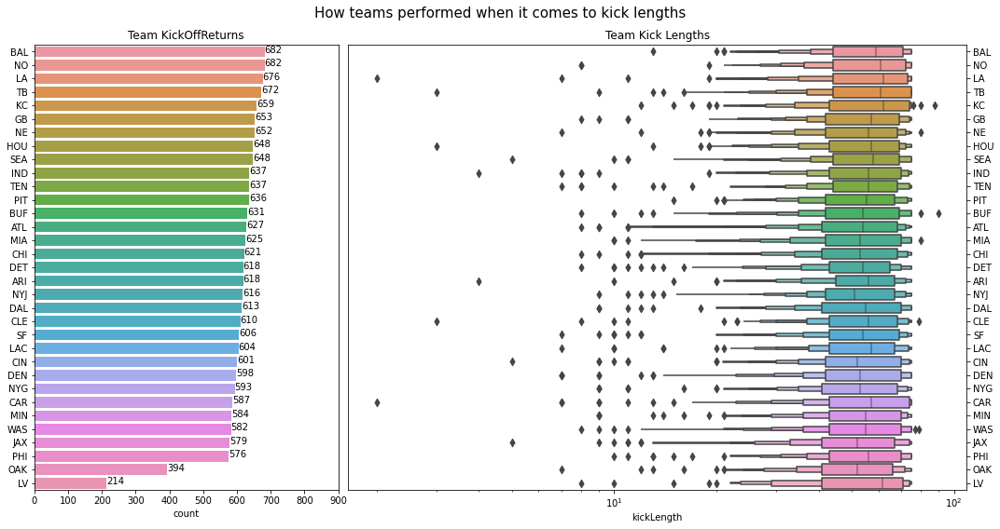

In [12]:

color_counts = (plays_df['possessionTeam'].value_counts().reset_index())
color_counts.columns = ['possessionTeam', 'count']

order = color_counts['possessionTeam']
palette = color_counts['possessionTeam'].replace('other', None) # "other" is not a color name

fig = plt.figure(figsize=(15, 8))
gs = gridspec.GridSpec(1, 3, figure=fig)

# Left plot
ax = fig.add_subplot(gs[0])
sns.barplot(data = color_counts, x = 'count', y = 'possessionTeam',
            #palette = palette, 
            ax = ax)
ax.set(title = 'Team KickOffReturns')
ax.set_xlim((0, 900))
for p in ax.patches:
    ax.annotate(f"{int(p.get_width())}", xy = (p.get_width(), p.get_y() + 0.5),
                horizontalalignment = 'left')
    clr = p.get_facecolor()
    if clr == (1, 1, 1, 1):
        # If facecolor is white
        p.set_edgecolor('magenta')
ax.set_ylabel('')


# Right plot
ax = fig.add_subplot(gs[1:3])
sns.boxenplot(data = plays_df, x = 'kickLength', y = 'possessionTeam',
              order = order, 
              #palette = palette, 
              ax = ax)
ax.set(title = 'Team Kick Lengths', xscale = 'log')
ax.yaxis.tick_right()
ax.set_ylabel('')

plt.suptitle("How teams performed when it comes to kick lengths", fontsize = 15)
plt.tight_layout()
plt.show()

 

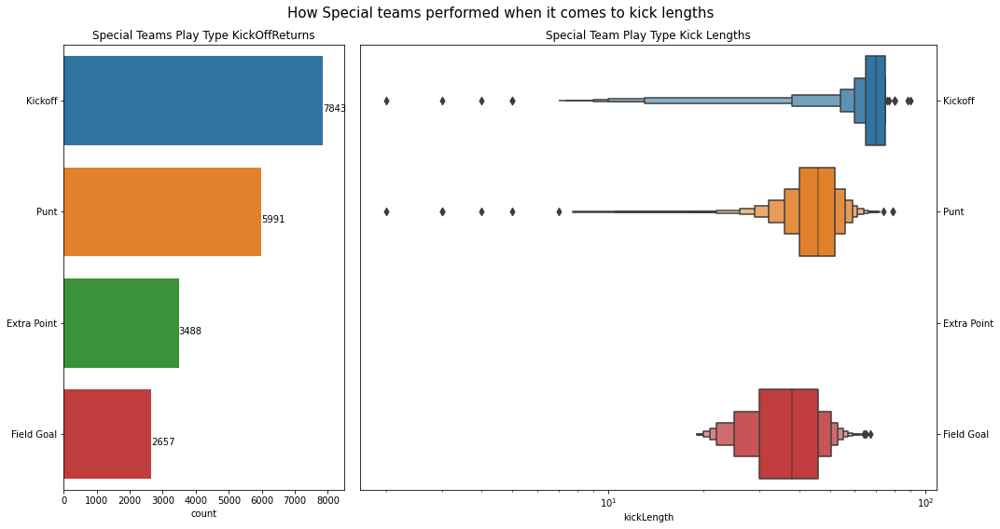

In [13]:

color_counts = (plays_df['specialTeamsPlayType'].value_counts().reset_index())
color_counts.columns = ['specialTeamsPlayType', 'count']

order = color_counts['specialTeamsPlayType']
palette = color_counts['specialTeamsPlayType'].replace('other', None) # "other" is not a color name

fig = plt.figure(figsize=(15, 8))
gs = gridspec.GridSpec(1, 3, figure=fig)

# Left plot
ax = fig.add_subplot(gs[0])
sns.barplot(data = color_counts, x = 'count', y = 'specialTeamsPlayType',
            #palette = palette, 
            ax = ax)
ax.set(title = 'Special Teams Play Type KickOffReturns')
ax.set_xlim((0, 8500))
for p in ax.patches:
    ax.annotate(f"{int(p.get_width())}", xy = (p.get_width(), p.get_y() + 0.5),
                horizontalalignment = 'left')
    clr = p.get_facecolor()
    if clr == (1, 1, 1, 1):
        # If facecolor is white
        p.set_edgecolor('magenta')
ax.set_ylabel('')


# Right plot
ax = fig.add_subplot(gs[1:3])
sns.boxenplot(data = plays_df, x = 'kickLength', y = 'specialTeamsPlayType',
              order = order, 
              #palette = palette, 
              ax = ax)
ax.set(title = 'Special Team Play Type Kick Lengths', xscale = 'log')
ax.yaxis.tick_right()
ax.set_ylabel('')

plt.suptitle("How Special teams performed when it comes to kick lengths", fontsize = 15)
plt.tight_layout()
plt.show()

 

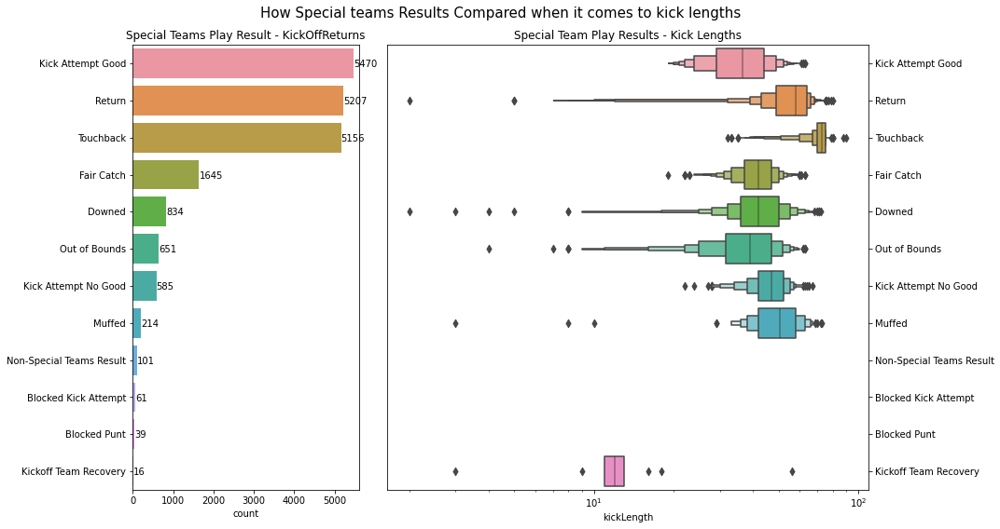

In [14]:

color_counts = (plays_df['specialTeamsResult'].value_counts().reset_index())
color_counts.columns = ['specialTeamsResult', 'count']

order = color_counts['specialTeamsResult']
palette = color_counts['specialTeamsResult'].replace('other', None) # "other" is not a color name

fig = plt.figure(figsize=(15, 8))
gs = gridspec.GridSpec(1, 3, figure=fig)

# Left plot
ax = fig.add_subplot(gs[0])
sns.barplot(data = color_counts, x = 'count', y = 'specialTeamsResult',
            #palette = palette, 
            ax = ax)
ax.set(title = 'Special Teams Play Result - KickOffReturns')
ax.set_xlim((0, 5600))
for p in ax.patches:
    ax.annotate(f"{int(p.get_width())}", xy = (p.get_width(), p.get_y() + 0.5),
                horizontalalignment = 'left')
    clr = p.get_facecolor()
    if clr == (1, 1, 1, 1):
        # If facecolor is white
        p.set_edgecolor('magenta')
ax.set_ylabel('')


# Right plot
ax = fig.add_subplot(gs[1:3])
sns.boxenplot(data = plays_df, x = 'kickLength', y = 'specialTeamsResult',
              order = order, 
              #palette = palette, 
              ax = ax)
ax.set(title = 'Special Team Play Results - Kick Lengths', xscale = 'log')
ax.yaxis.tick_right()
ax.set_ylabel('')

plt.suptitle("How Special teams Results Compared when it comes to kick lengths", fontsize = 15)
plt.tight_layout()
plt.show()

 

# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">4.Let us do Visualization Plot.ly and GroupBy </span>


In [15]:
df_temp = pd.DataFrame(plays_df.groupby(['specialTeamsPlayType']).specialTeamsResult.count())
df_temp2 = pd.DataFrame(plays_df.groupby(['specialTeamsResult']).specialTeamsResult.count())
df_temp3= pd.DataFrame(plays_df.groupby(['specialTeamsPlayType', 'specialTeamsResult']).count()).reset_index()
df_temp=df_temp.rename(columns={"specialTeamsResult": "NumberOfPlays"})
df_temp2=df_temp2.rename(columns={"specialTeamsResult": "NumberOfPlays"})
df_temp=df_temp.fillna(0)

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.1.Some Plots based on Number of Special Team plays </span>


</span>


In [16]:

fig = px.box(df_temp, x="NumberOfPlays")
fig.show()
fig = px.bar(df_temp, x="NumberOfPlays")
fig.show()
fig = px.box(df_temp2, x="NumberOfPlays")
fig.show()
fig = px.bar(df_temp2, x="NumberOfPlays")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x='gameId', y='specialTeamsResult')#, color='specialTeamsPlayType')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x='gameId', y='specialTeamsResult', color='specialTeamsPlayType')

 

In [17]:
del df_temp
del df_temp3
del df_temp2

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.2.Some Plots based on Number of Special Team play Types </span>


In [18]:
df_temp = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType']).kickLength.sum())
df_temp2 = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsResult']).kickLength.sum())
df_temp3= pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType', 'specialTeamsResult']).sum()).reset_index()
df_temp=df_temp.fillna(0)

In [19]:

fig = px.box(df_temp2, x="kickLength")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="kickLength" , color='specialTeamsResult')#, color='specialTeamsPlayType')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="kickLength" , color='specialTeamsPlayType')
fig.show()
 

In [20]:
del df_temp
del df_temp3
del df_temp2

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.3.Some Plots based on Number of Special Team Kick Return Yardage </span>


In [21]:

df_temp = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType']).kickReturnYardage.sum())
df_temp2 = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsResult']).kickReturnYardage.sum())
df_temp3= pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType', 'specialTeamsResult']).sum()).reset_index()
df_temp=df_temp.fillna(0)
fig = px.box(df_temp2, x="kickReturnYardage")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="kickReturnYardage" , color='specialTeamsResult')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="kickReturnYardage" , color='specialTeamsPlayType')
fig.show()
del df_temp
del df_temp3
del df_temp2
 

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.4.Statistics based on absoluteYardlineNumber of each team and special team actions </span>


In [22]:

df_temp = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType']).absoluteYardlineNumber.count())
df_temp2 = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsResult']).absoluteYardlineNumber.count())
df_temp3= pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType', 'specialTeamsResult','absoluteYardlineNumber']).count()).reset_index()
df_temp=df_temp.fillna(0)
fig = px.violin(df_temp2, x="absoluteYardlineNumber")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="absoluteYardlineNumber" , color='specialTeamsResult')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="absoluteYardlineNumber" , color='specialTeamsPlayType')
fig.show()
del df_temp
del df_temp3
del df_temp2

 

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.5.Some Plots based on Number of Special Team Penalty Yards Impact </span>


In [23]:

df_temp = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType']).penaltyYards.count())
df_temp2 = pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsResult']).penaltyYards.count())
df_temp3= pd.DataFrame(plays_df.groupby(['possessionTeam','specialTeamsPlayType', 'specialTeamsResult','penaltyYards']).count()).reset_index()
df_temp=df_temp.fillna(0)
fig = px.violin(df_temp2, x="penaltyYards")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="penaltyYards" , color='specialTeamsResult')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="penaltyYards" , color='specialTeamsPlayType')
fig.show()
del df_temp
del df_temp3
del df_temp2

 


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.6 Let us try some seaborn Pair Plot Charts </span>



## <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.6.1 Full seaborn Pair Plot Charts </span>


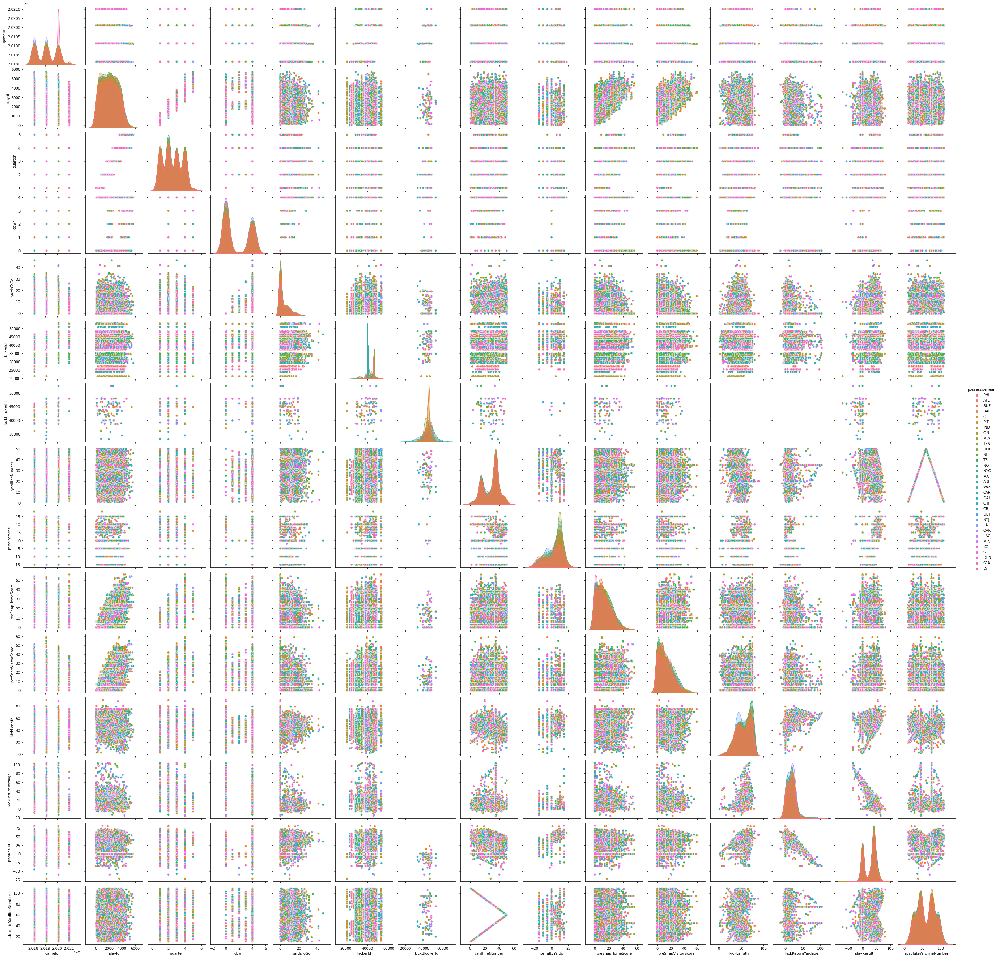

In [24]:
sns.pairplot(plays_df, hue="possessionTeam")



## <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.6.2 Full seaborn Pair Plot Chart with a histogram in the diagonal plot </span>


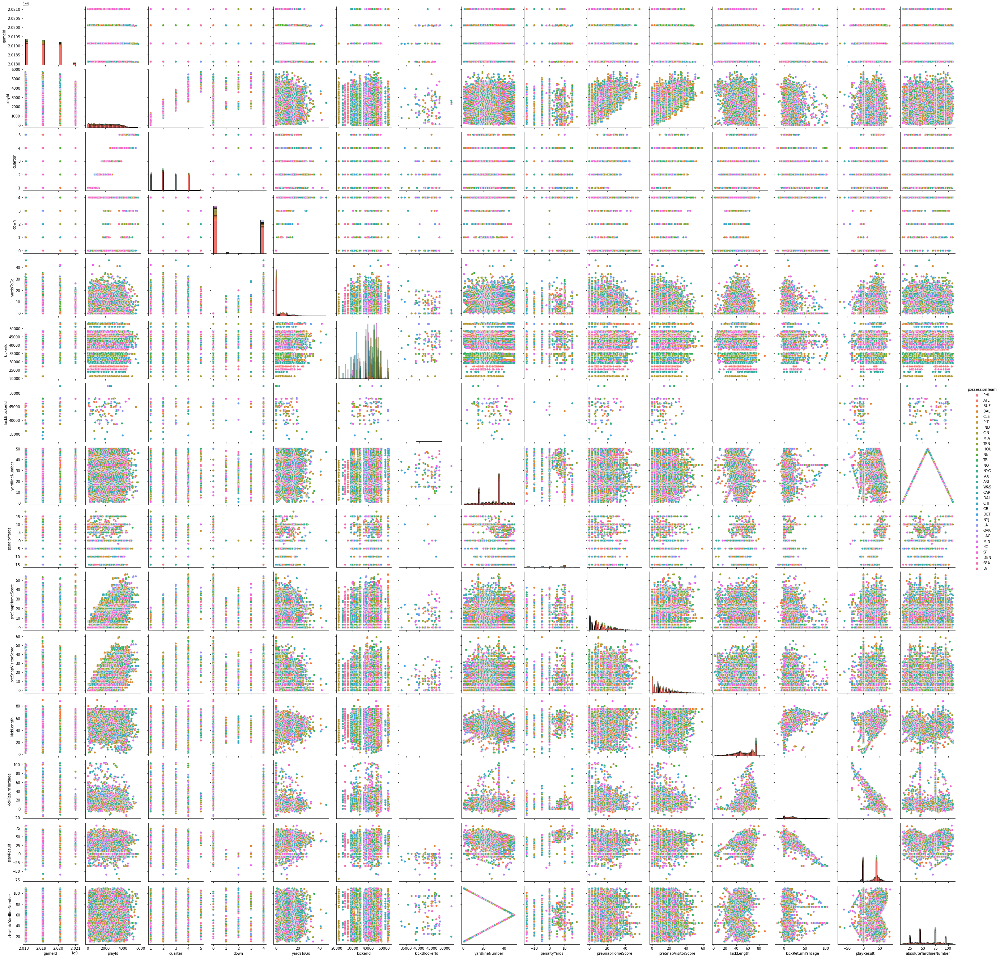

In [25]:
sns.pairplot(plays_df, hue="possessionTeam",diag_kind="hist")


## <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.6.3 Full seaborn Pair Plot Chart with a hue on Possession Time </span>


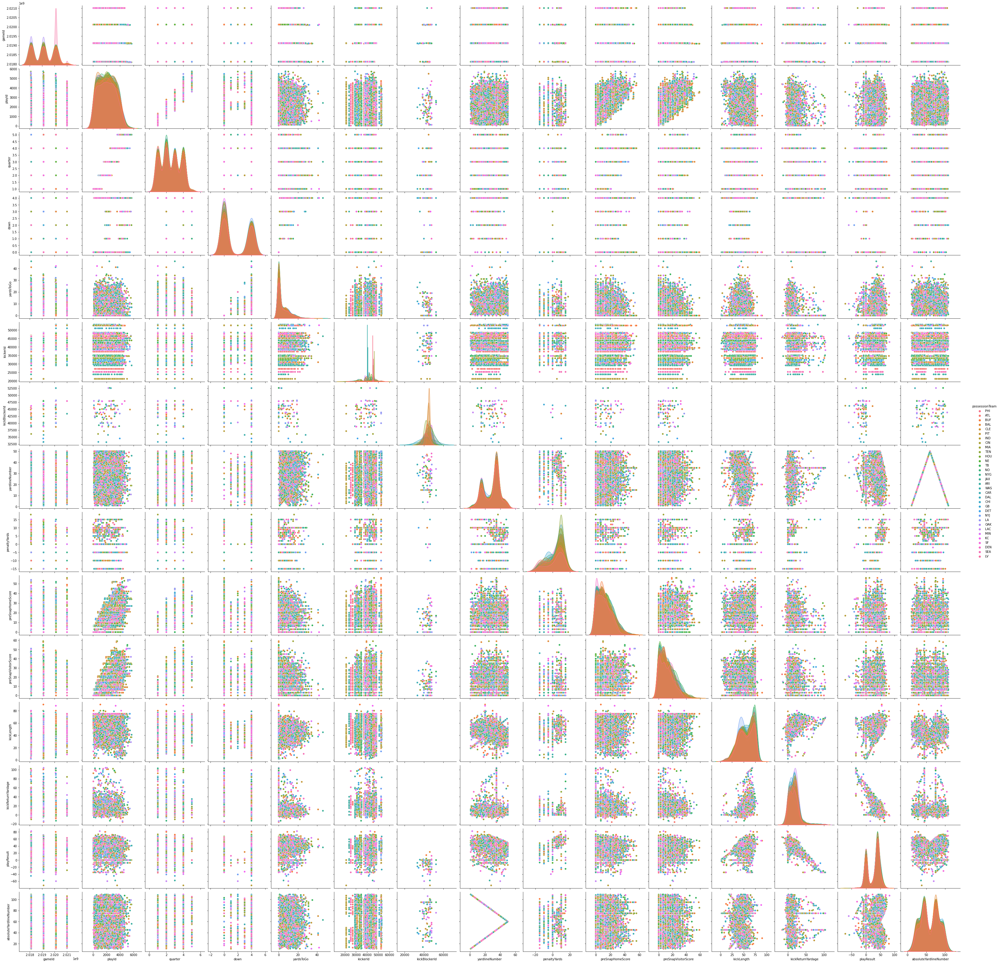

In [26]:
sns.pairplot(plays_df, hue="possessionTeam", height=3)


## <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.6.3 Full seaborn Pair Plot Chart with a hue on Possession Time </span>


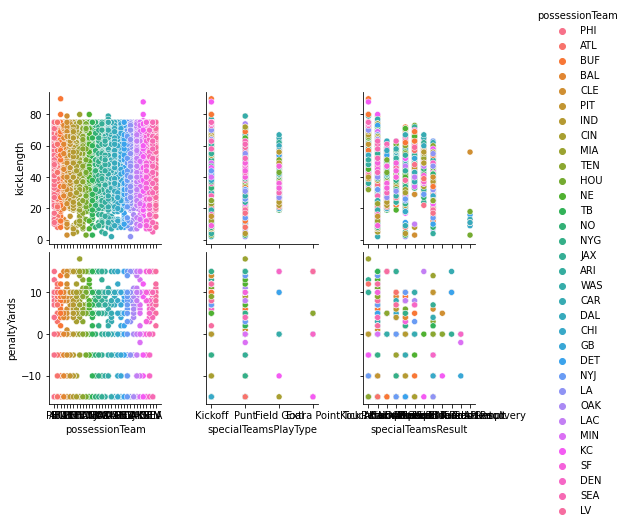

In [27]:

sns.pairplot(
    plays_df,
    x_vars=["possessionTeam", "specialTeamsPlayType", "specialTeamsResult"],
    y_vars=["kickLength", "penaltyYards"],
    hue='possessionTeam',
)




## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.7 A FacetGrid Plot </span>


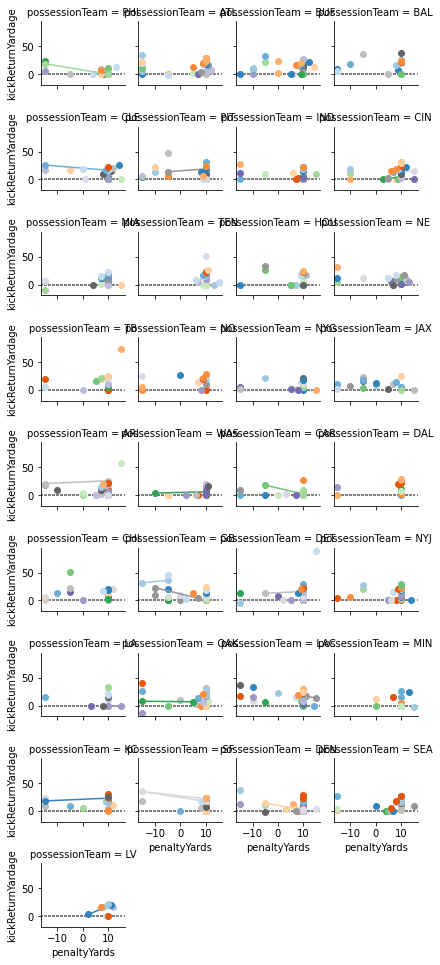

In [28]:

# Initialize a grid of plots with an Axes for each walk
grid = sns.FacetGrid(plays_df, col="possessionTeam", hue="kickLength", palette="tab20c",
                     col_wrap=4, height=1.5)

# Draw a horizontal line to show the starting point
grid.refline(y=0, linestyle=":")

# Draw a line plot to show the trajectory of each random walk
grid.map(plt.plot, "penaltyYards", "kickReturnYardage", marker="o")

# Adjust the arrangement of the plots
grid.fig.tight_layout(w_pad=1)

 


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.8 Let us plot some playes from 2018 play dataset </span>


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.1 Let us load the plays dataset </span>

In [29]:
tr_2018 = '../input/nfl-big-data-bowl-2022/tracking2018.csv'
tracking2018 = pd.read_csv(tr_2018)


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.2 Let us plot the football field </span>

In [30]:
#football field - code from  https://www.kaggle.com/jaronmichal/tracking-data-visualization 
import matplotlib.patches as patches
from matplotlib.patches import Arc
from matplotlib import pyplot as plt
import matplotlib.patches as mpatches

# Change size of the figure
plt.rcParams['figure.figsize'] = [24, 16]
def drawPitch(width, height, color="w"):
    fig = plt.figure()
    ax = plt.axes(xlim=(-10, width + 30), ylim=(-15, height + 5))
    plt.axis('off')

    # Grass around pitch
    rect = patches.Rectangle((-10, -5), width + 40, height + 10, linewidth=1, facecolor='#3f995b', capstyle='round')
    ax.add_patch(rect)
    ###################

    # Pitch boundaries
    rect = plt.Rectangle((0, 0), width + 20, height, ec=color, fc="None", lw=2)
    ax.add_patch(rect)
    ###################

    # vertical lines - every 5 yards
    for i in range(21):
        plt.plot([10 + 5 * i, 10 + 5 * i], [0, height], c="w", lw=2)
    ###################
        
    # distance markers - every 10 yards
    for yards in range(10, width, 10):
        yards_text = yards if yards <= width / 2 else width - yards
        # top markers
        plt.text(10 + yards - 2, height - 7.5, yards_text, size=15, c="w", weight="bold")
        # botoom markers
        plt.text(10 + yards - 2, 7.5, yards_text, size=15, c="w", weight="bold", rotation=180)
    ###################

    # yards markers - every yard
    # bottom markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [1, 3], color="w", lw=2)

    # top markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [height - 1, height - 3], color="w", lw=2)

    # middle bottom markers
    y = (height - 18.5) / 2
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [y, y + 2], color="w", lw=2)

    # middle top markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [height - y, height - y - 2], color="w", lw=2)
    ###################

    # draw home end zone
    plt.text(2.5, (height - 15) / 2, "HOME", size=30, c="w", weight="bold", rotation=90)
    rect = plt.Rectangle((0, 0), 10, height, ec=color, fc="#0064dc", lw=2)
    ax.add_patch(rect)

    # draw away end zone    
    plt.text(111, (height - 15) / 2, "AWAY", size=30, c="w", weight="bold", rotation=-90)
    rect = plt.Rectangle((width + 10, 0), 10, height, ec=color, fc="#c80014", lw=2)
    ax.add_patch(rect)
    ###################
    
    # draw extra spot point
    # left
    y = (height - 3) / 2
    plt.plot([10 + 2, 10 + 2], [y, y + 3], c="w", lw=2)
    
    # right
    plt.plot([width + 10 - 2, width + 10 - 2], [y, y + 3], c="w", lw=2)
    ###################
    
    # draw goalpost
    goal_width = 6 # yards
    y = (height - goal_width) / 2
    # left
    plt.plot([0, 0], [y, y + goal_width], "-", c="y", lw=10, ms=20)
    # right
    plt.plot([width + 20, width + 20], [y, y + goal_width], "-", c="y", lw=10, ms=20)
    
    return fig, ax


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.3 Plot a play for different roles</span>

In [31]:
from cycler import cycler
custom_cycler = (cycler(color=['b','k','m','g']))

In [32]:
def plot_play(df, gameId, position):
    fig, ax = drawPitch(100, 54)
    ax.set_prop_cycle(custom_cycler)
    df.query('gameId == ' + gameId + ' and position == "' + position +  '"').groupby('team').plot(x='x', y='y', ax=ax, style='.')
    plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
    plt.legend().remove()

Plotting for a CB Postion performance
Plotting for a OLB Postion performance
Plotting for a WR Postion performance
Plotting for a RB Postion performance
Plotting for a TE Postion performance
Plotting for a LB Postion performance
Plotting for a ILB Postion performance
Plotting for a K Postion performance
Plotting for a P Postion performance


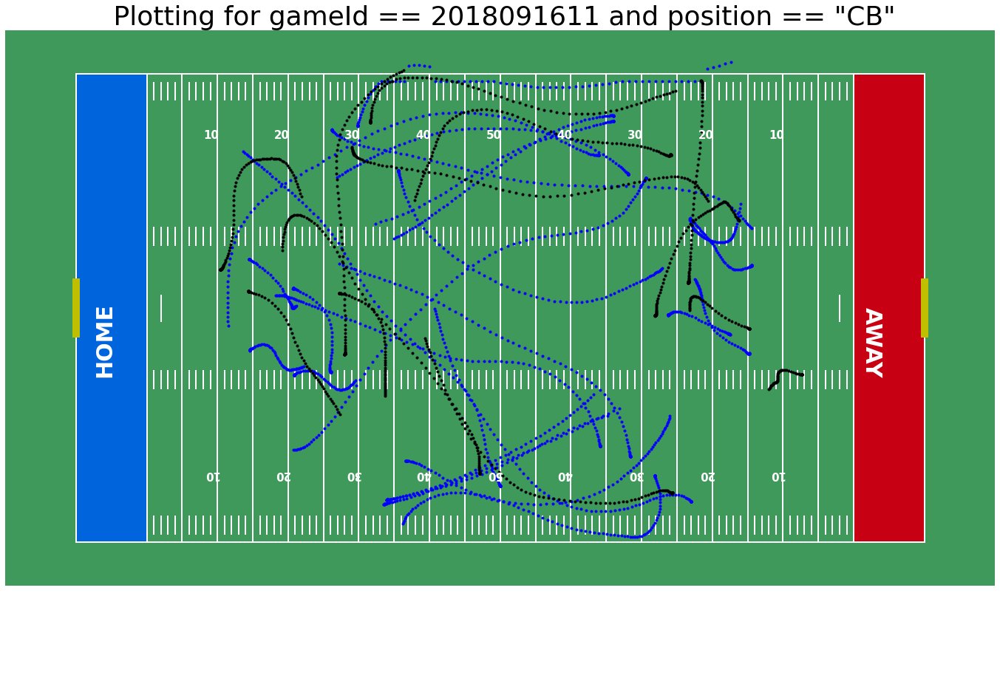

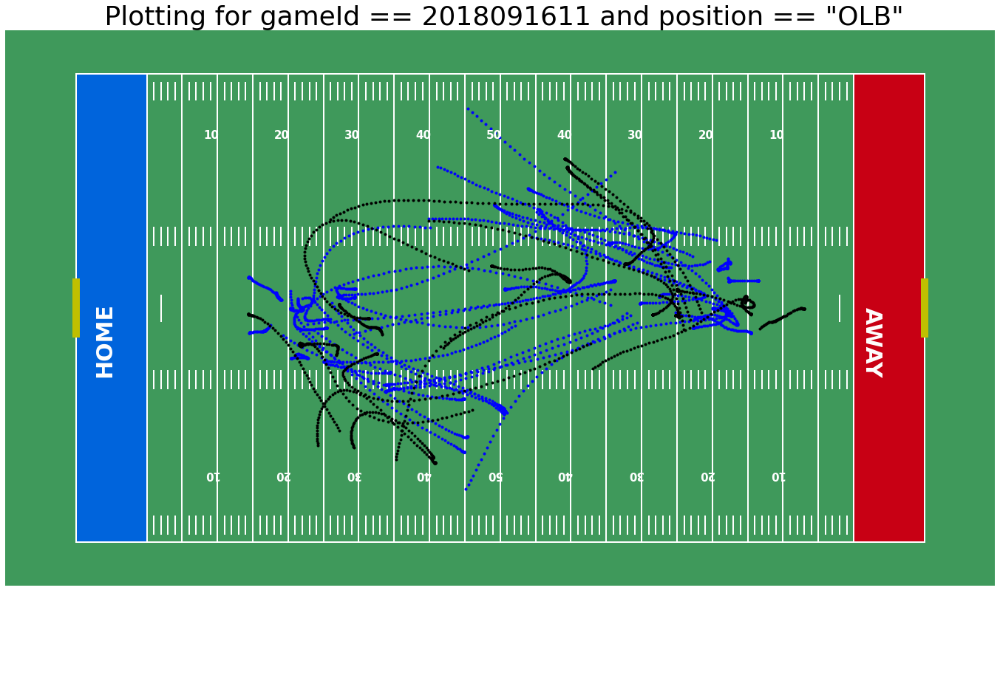

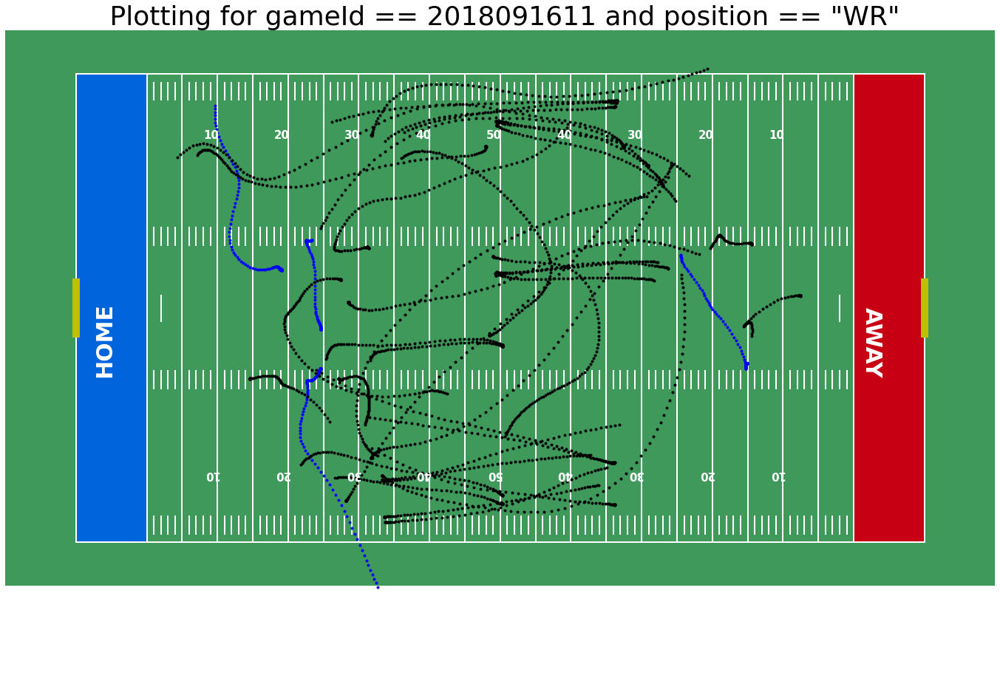

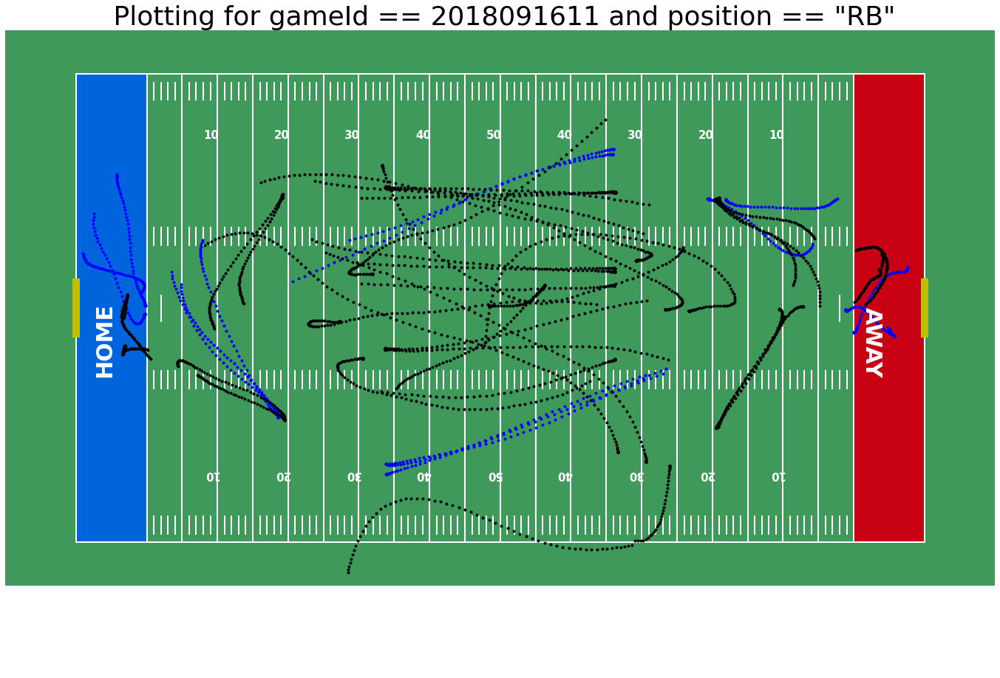

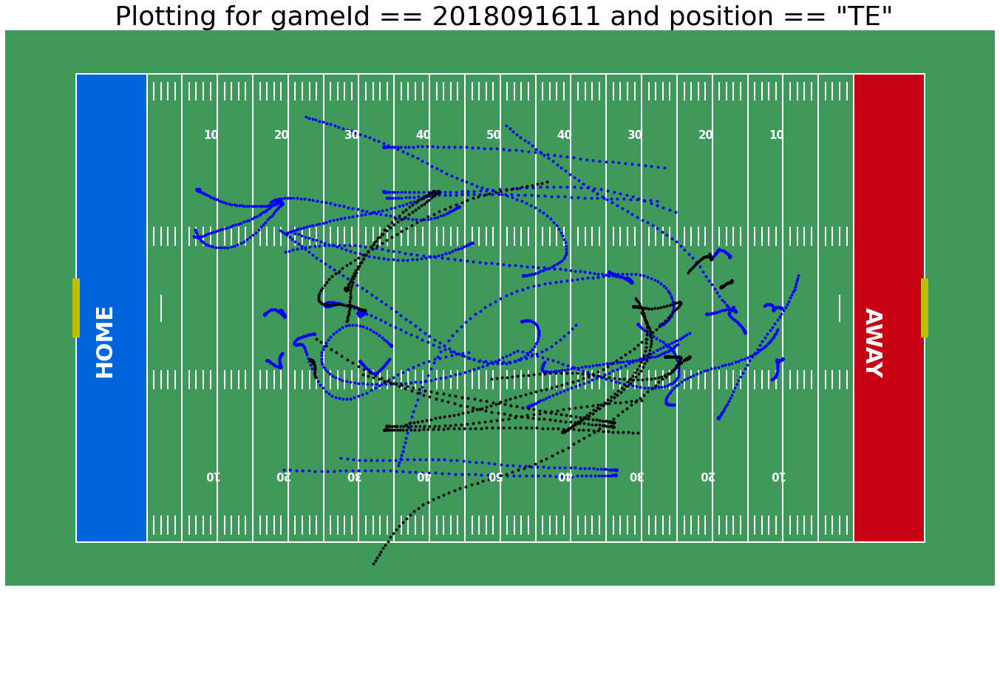

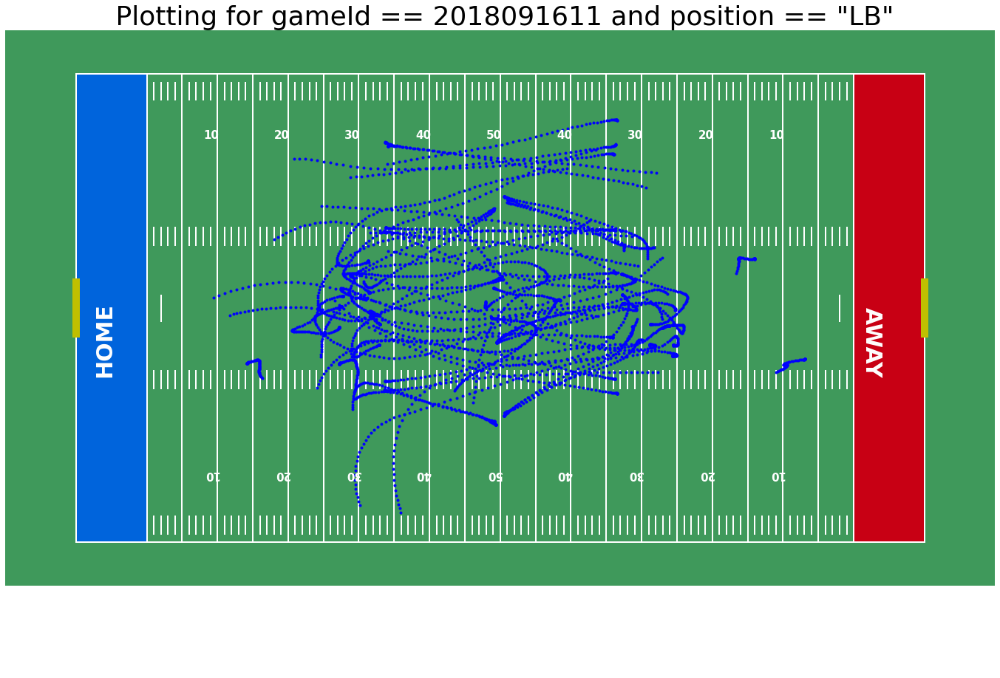

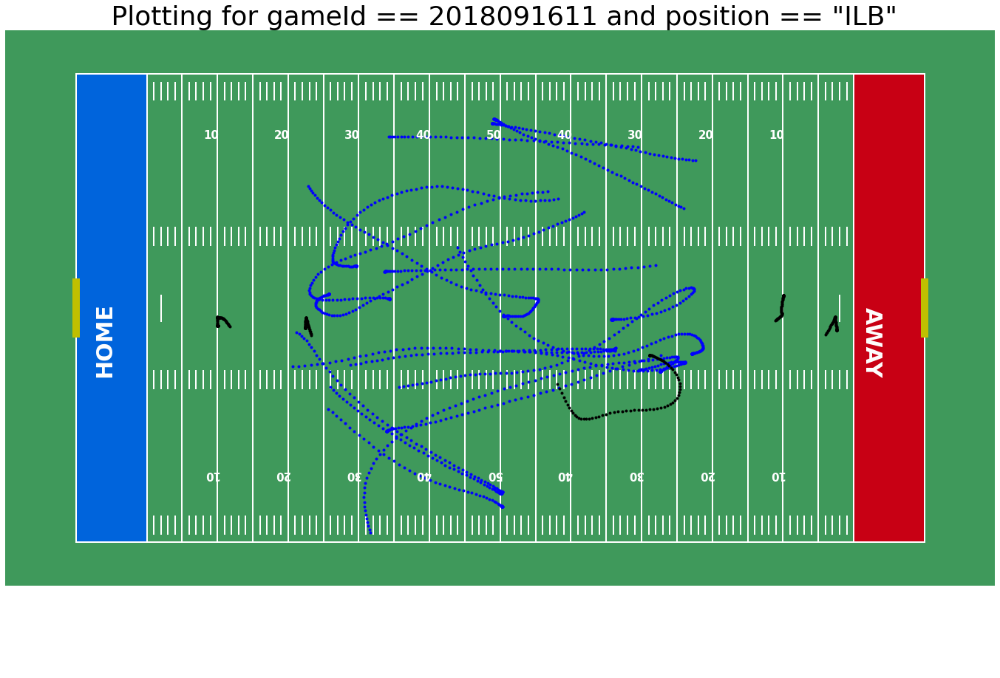

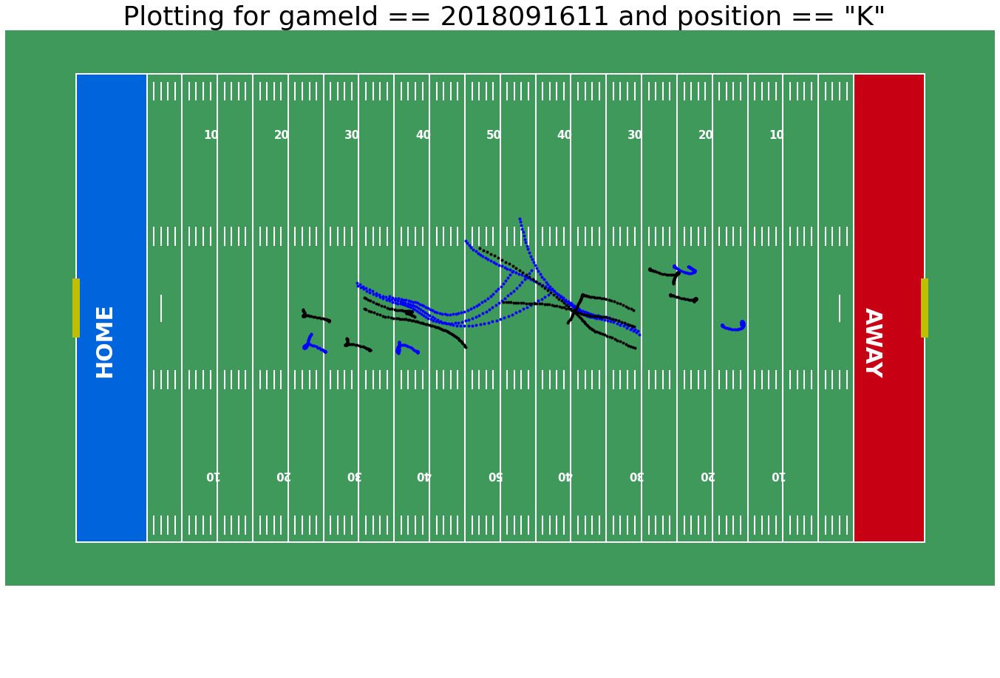

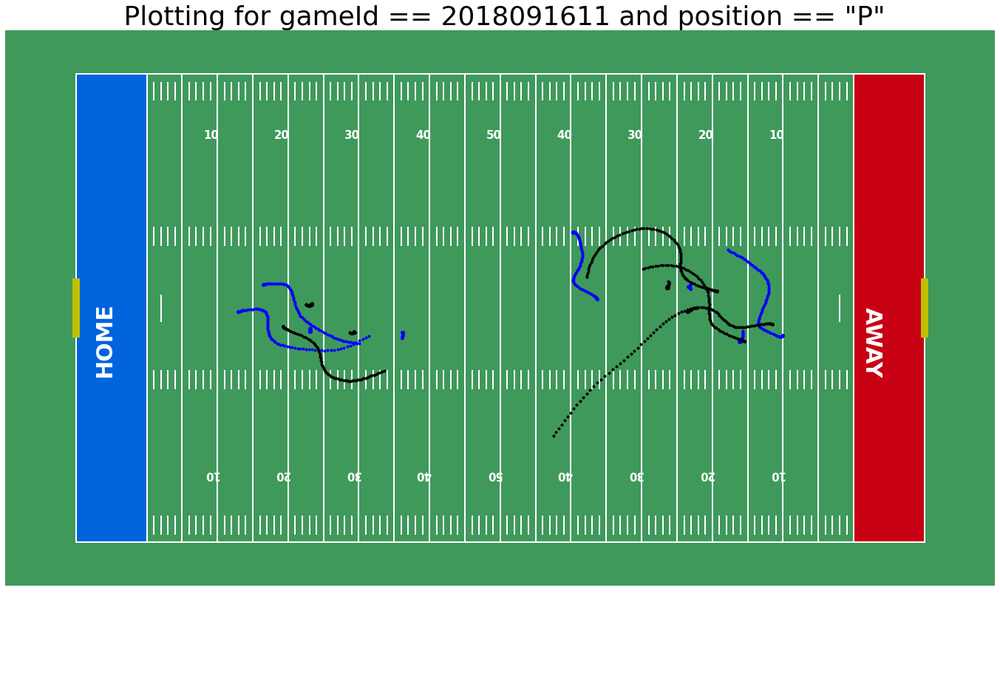

In [33]:
poslist = ["CB","OLB","WR","RB","TE","LB","ILB","K","P"]
for position in poslist:
    print('Plotting for a ' + position + ' Postion performance')
    plot_play(tracking2018,'2018091611', position)

### <span class="title-section w3-medium" style="color:#DC143C" id="codebook">4.8.3.1 Plot a play for Running Backs</span>

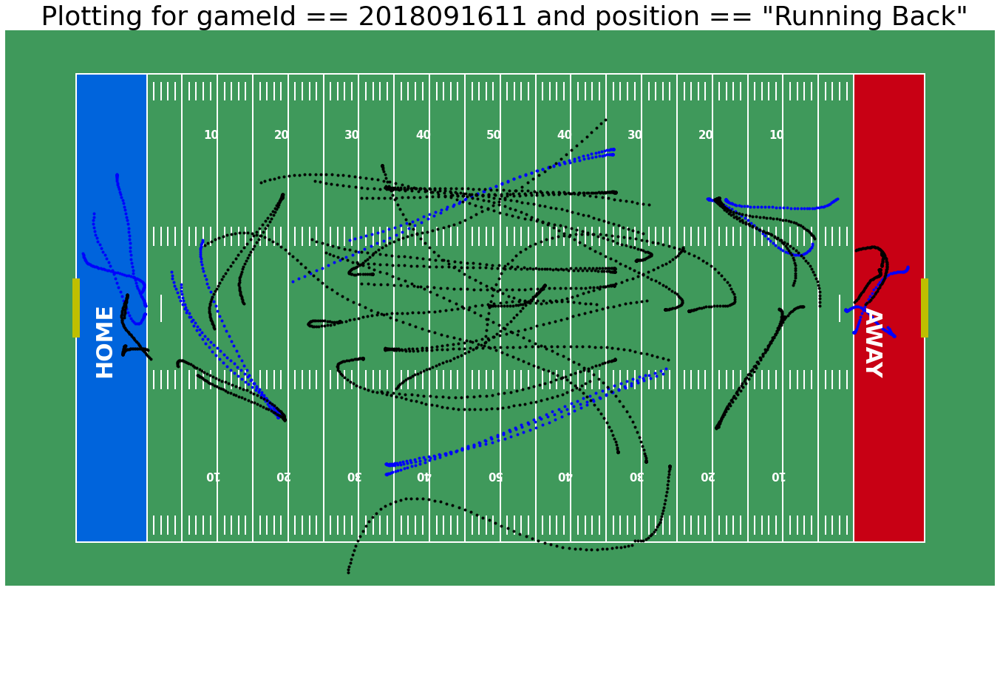

In [34]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)


tracking2018.query('gameId == 2018091611 and position == "RB"').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
position = "Running Back"
plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
plt.legend().remove();

### <span class="title-section w3-medium" style="color:#DC143C" id="codebook">4.8.3.2 Plot a play for Quarter Backs</span>

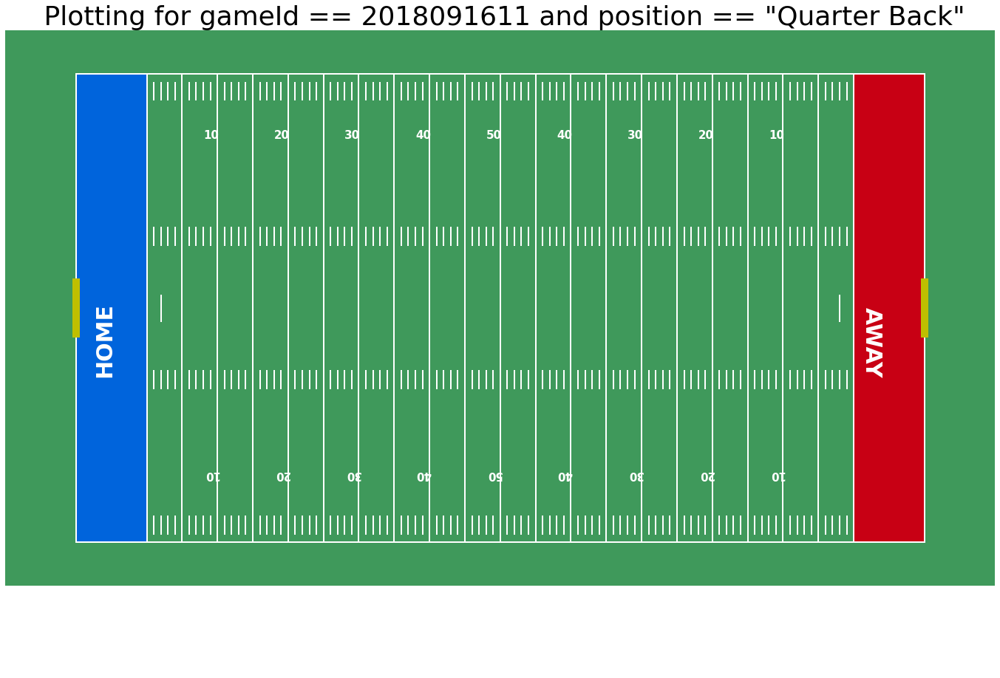

In [35]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)

tracking2018.query('gameId == 2018091611 and position == "QB"').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
position = "Quarter Back"
plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
plt.legend().remove();

### <span class="title-section w3-medium" style="color:#DC143C" id="codebook">4.8.3.3 Plot a play for Wide Receiver</span>

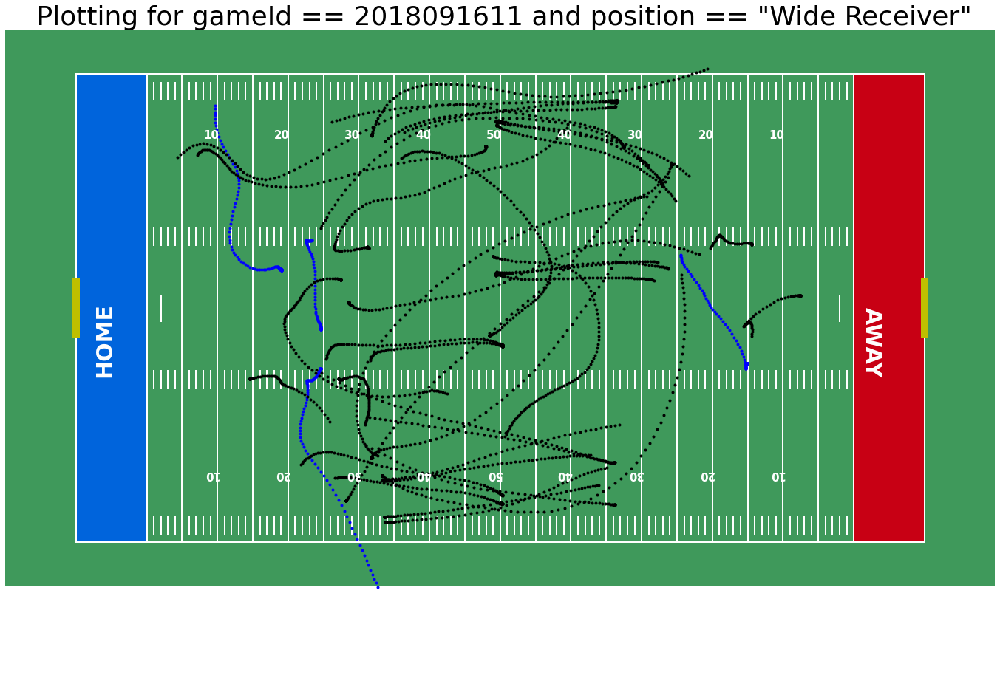

In [36]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)

tracking2018.query('gameId == 2018091611 and position == "WR"').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
position = "Wide Receiver"
plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
plt.legend().remove();

### <span class="title-section w3-medium" style="color:#DC143C" id="codebook">4.8.3.4 Plot a play for Center Back</span>

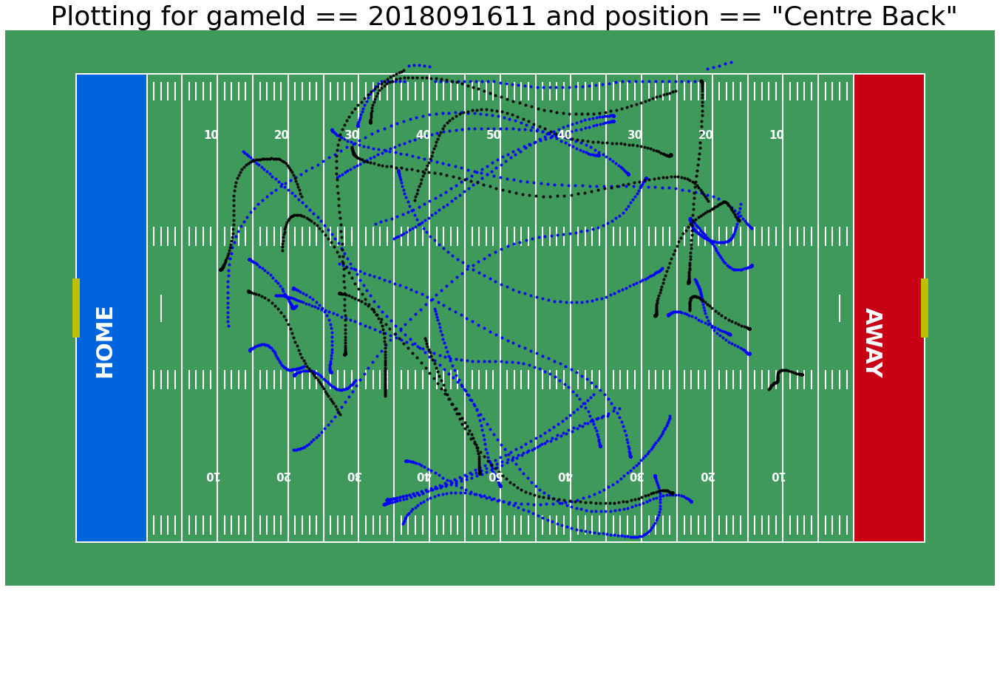

In [37]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)

tracking2018.query('gameId == 2018091611 and position == "CB"').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
position = "Centre Back"
plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
plt.legend().remove();

### <span class="title-section w3-medium" style="color:#DC143C" id="codebook">4.8.3.5 Plot a play for a Kicker</span>

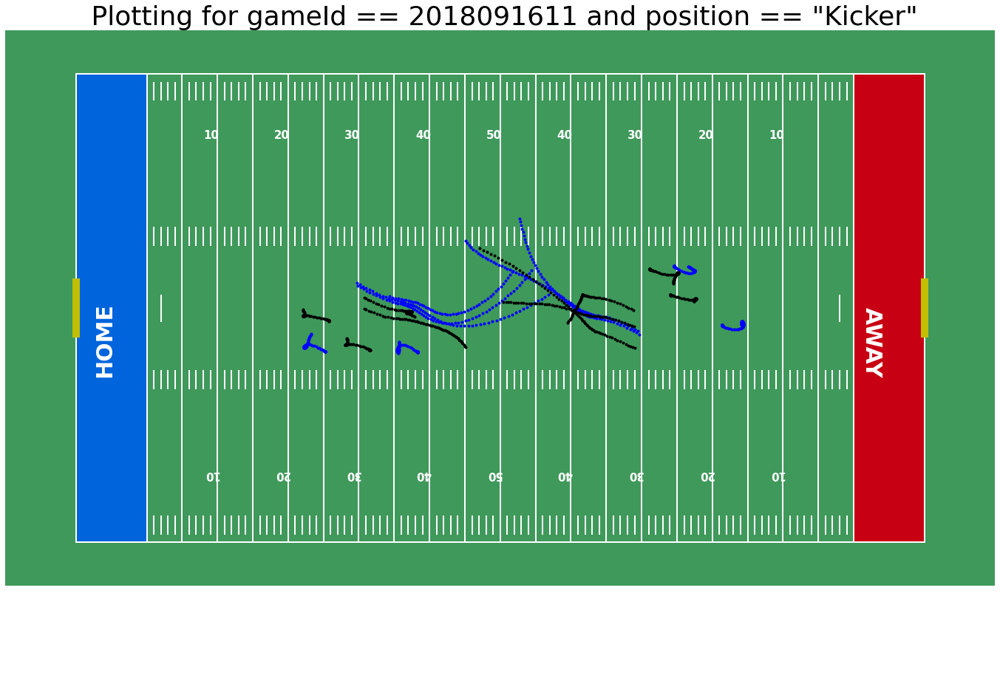

In [38]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)


tracking2018.query('gameId == 2018091611 and position == "K"').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
position = "Kicker"
plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
plt.legend().remove();

### <span class="title-section w3-medium" style="color:#DC143C" id="codebook">4.8.3.6 Plot a play for a Punter</span>

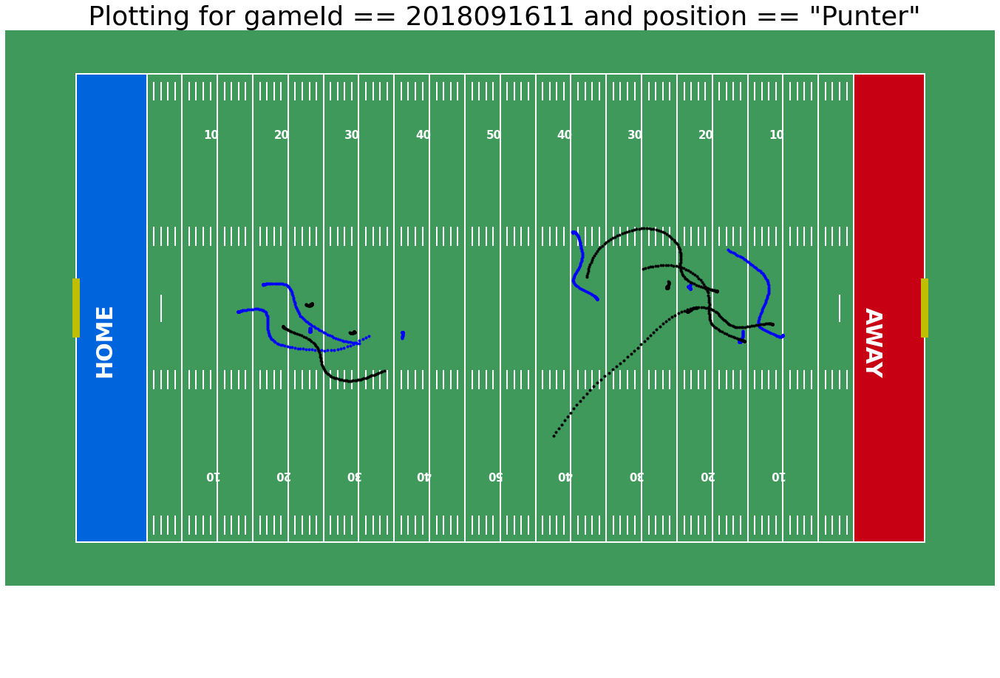

In [39]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)

tracking2018.query('gameId == 2018091611 and position == "P"').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
position = "Punter"
plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
plt.legend().remove();


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.4 Plot a play for the entire team</span>

Play Summary for gameId == 2018091611 and playId == 2752


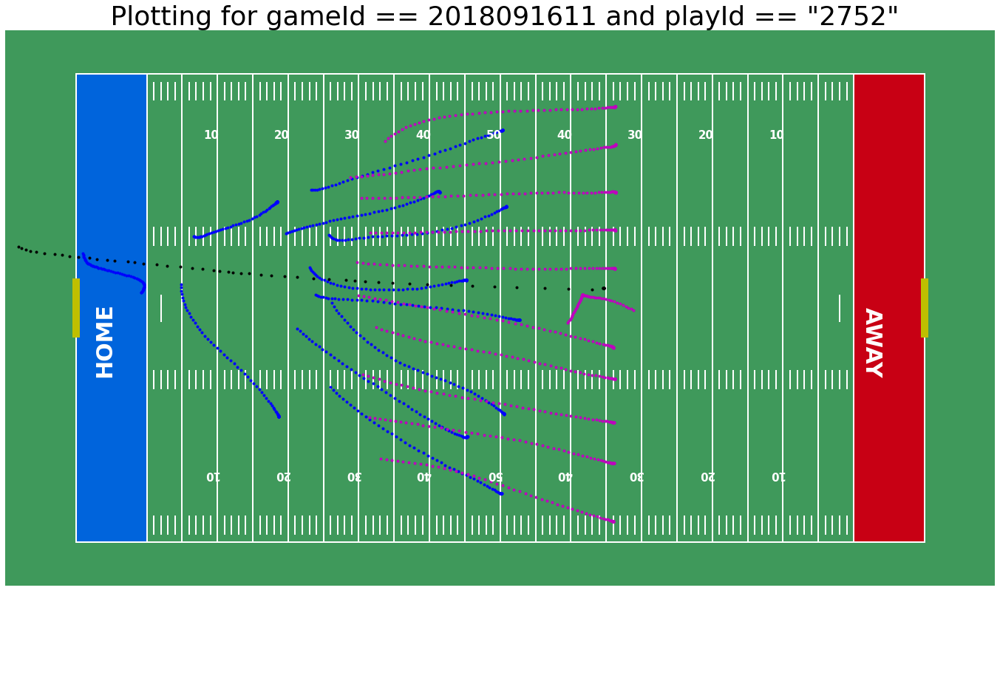

In [40]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)
print('Play Summary for gameId == 2018091611 and playId == 2752')
tracking2018.query('gameId == 2018091611 and playId == 2752').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
playId = "2752"
plt.title(' Plotting for gameId == ' + gameId + ' and playId == "' + playId +  '"',fontsize=36,ha='center')
plt.legend().remove();


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.5 Plot a play for a Outside Line backer</span>

Play Summary forgameId == 2018091611 and position == "OLB"


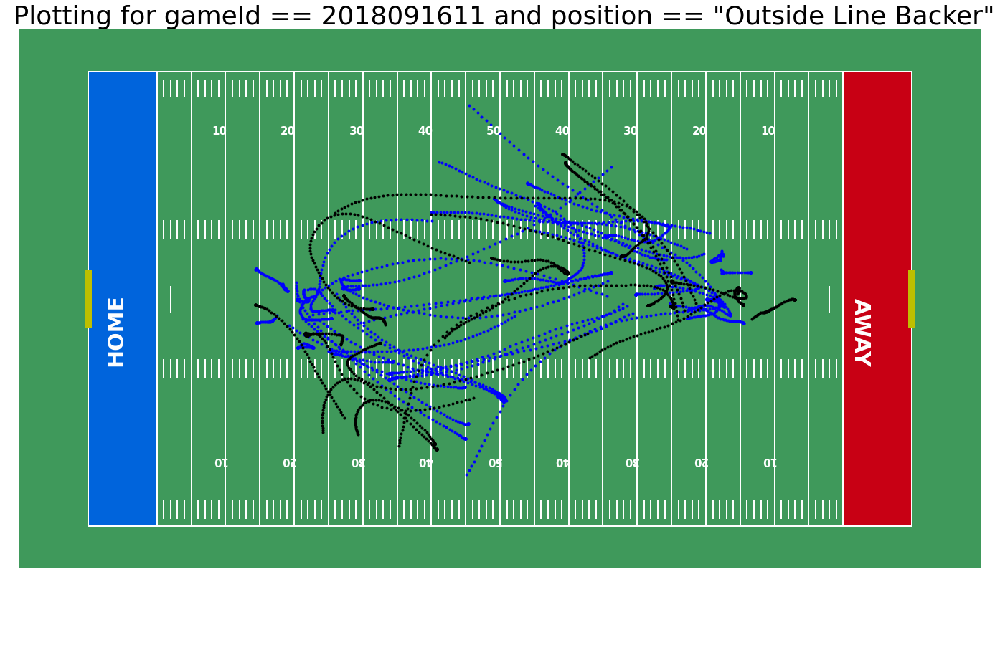

In [41]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)
print('Play Summary forgameId == 2018091611 and position == "OLB"')
tracking2018.query('gameId == 2018091611 and position == "OLB"').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2018091611"
position = "Outside Line Backer"
plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
plt.legend().remove();


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.6 Dynamic Pull down menu</span>
##### 
###### Code Inspired by https://www.kaggle.com/werooring/nfl-big-data-bowl-basic-eda-for-beginner

In [42]:
games_ids = {}
games_tracking2018 = tracking2018.groupby(by=["gameId"])
for game, data in games_tracking2018:
    games_ids[game] = list(set(data.playId.tolist()))

    

In [43]:

def extract_one_game(game_id, play_id, df):
    game = df[(df.gameId == game_id) & (df.playId == play_id)]
    home = {}
    away = {}
    balls = []
    
    players = game.sort_values(['frameId'], ascending=True).groupby('nflId')
    for id, dx in players:
        jerseyNumber = int(dx.jerseyNumber.iloc[0])
        if dx.team.iloc[0] == "home":
            home[jerseyNumber] = list(zip(dx.x.tolist(), dx.y.tolist()))
        elif dx.team.iloc[0] == "away":
            away[jerseyNumber] = list(zip(dx.x.tolist(), dx.y.tolist()))


    ball_df = game.sort_values(['frameId'], ascending=True) 
    ball_df = ball_df[ball_df.team == "football"]
    balls = list(zip(ball_df.x.tolist(), ball_df.y.tolist()))
    return home, away, balls

In [44]:
from matplotlib import animation
from IPython.display import HTML
def animate_one_play(game_id, play_id, df):
    fig, ax = drawPitch(100, 53.3)
    
    home, away, balls = extract_one_game(game_id, play_id, df)

    team_left, = ax.plot([], [], '>', markersize=15, markerfacecolor="r", markeredgewidth=2, markeredgecolor="white", zorder=7)
    team_right, = ax.plot([], [], '<', markersize=15, markerfacecolor="b", markeredgewidth=2, markeredgecolor="white", zorder=7)
    ball, = ax.plot([], [], 'o', markersize=20, markerfacecolor="black", markeredgewidth=2, markeredgecolor="white", zorder=7)
    drawings = [team_left, team_right, ball]

    def init():
        team_left.set_data([], [])
        team_right.set_data([], [])
        ball.set_data([], [])
        return drawings

    def draw_teams(i):
        X = []
        Y = []
        for k, v in home.items():
            x, y = v[i]
            X.append(x)
            Y.append(y)
        team_left.set_data(X, Y)
        
        X = []
        Y = []
        for k, v in away.items():
            x, y = v[i]
            X.append(x)
            Y.append(y)
        team_right.set_data(X, Y)

    def animate(i):
        draw_teams(i)
        
        x, y = balls[i]
        ball.set_data([x, y])
        return drawings
    
    # !May take a while!
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(balls), interval=100, blit=True)

    return HTML(anim.to_html5_video())


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9 Animation for a play</span>


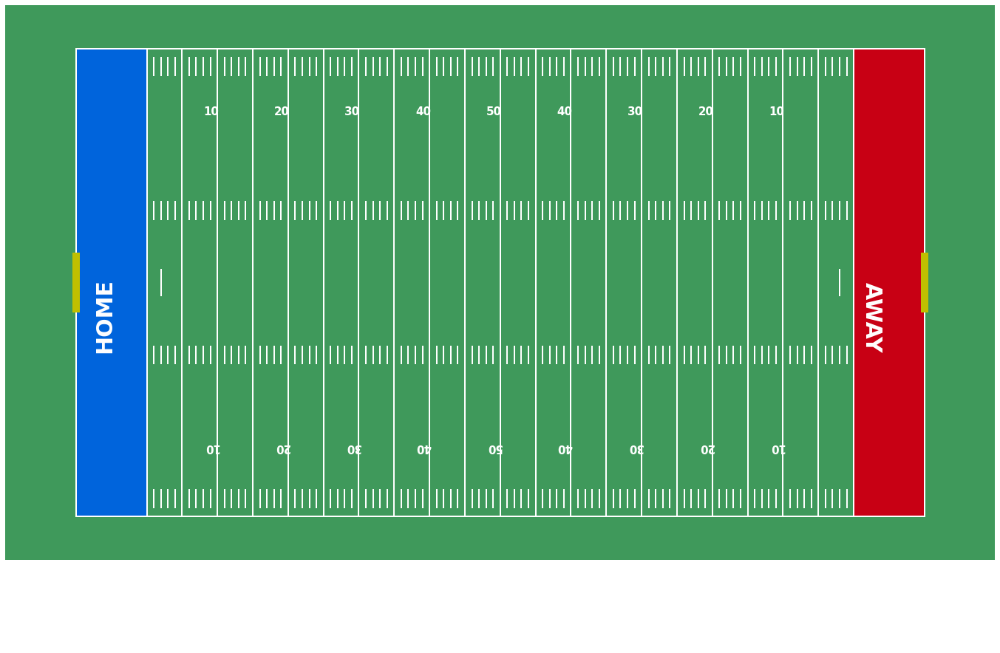

In [45]:
animate_one_play(2018121000, 4281, tracking2018)
gameid=2018123000
gamelist=(2018121000,2018121000,2018100704,2018111105,2018091610, 2018110401, 2018100701, 2018123005, 2018102102, 2018121606)
plays=(3312,241,324,3239,3871,2180,4281,993,1452,1977)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.1 Select a game</span>


In [46]:
import ipywidgets as widgets
from ipywidgets import interactive

games = sorted(tracking2018['gameId'].unique().tolist())
#games = sorted(df['Asset Type Description'].unique().tolist())
 
def view(x=''):
    return tracking2018[tracking2018['gameId']==x]
 
w = widgets.Dropdown(options=games,	description='Game:',    disabled=False,)

interactive(view, x=w)

interactive(children=(Dropdown(description='Game:', options=(2018090600, 2018090900, 2018090901, 2018090902, 2…

In [47]:
gameid = w.value

In [48]:
import random

#games = sorted(tracking2018['gameId'].unique().tolist())
plays = sorted(tracking2018[tracking2018['gameId']==gameid]['playId'])



## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.2 Random Play animation 1</span>

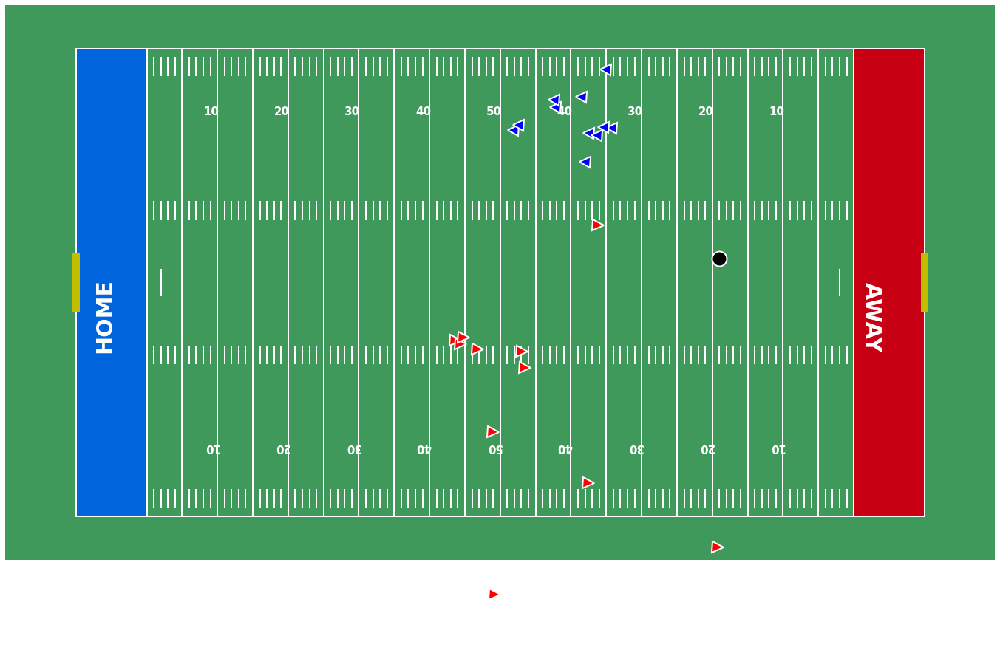

In [49]:
animate_one_play(2018121000, 3312, tracking2018)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.3 Random Play animation 2</span>

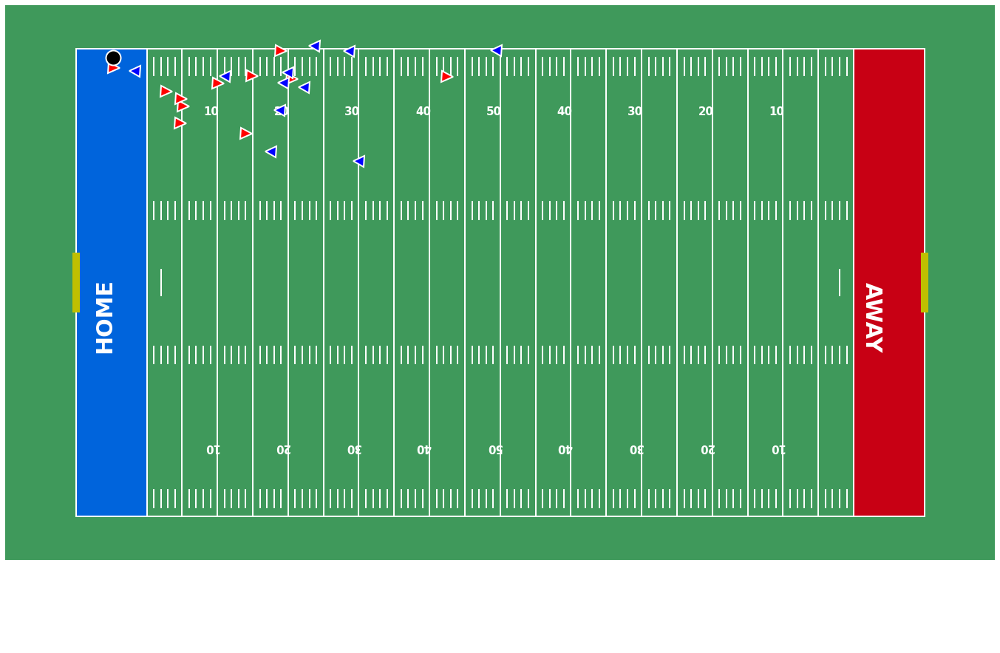

In [50]:
'''
gameid = 2018100704
playid = 3239
playid=random.choice(plays)
print('animation for ' , playid)
animate_one_play(gameid, plays[playid], tracking2018)
'''
animate_one_play(2018122400, 241, tracking2018)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.4 Random Play animation 3</span>

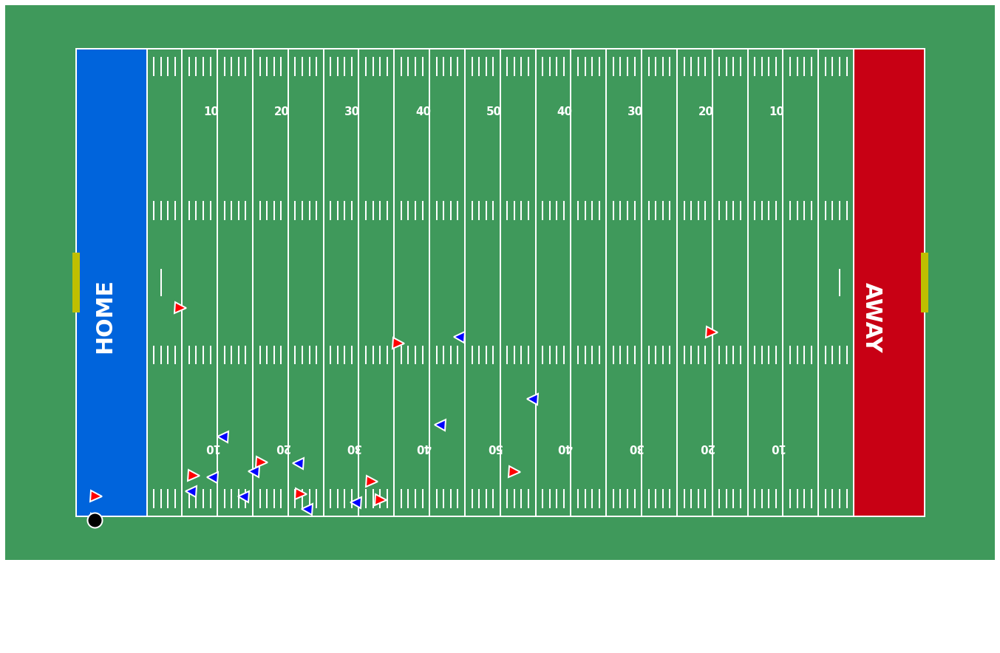

In [51]:
animate_one_play(2018111105, 3239, tracking2018)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.5 Random Play animation 4</span>

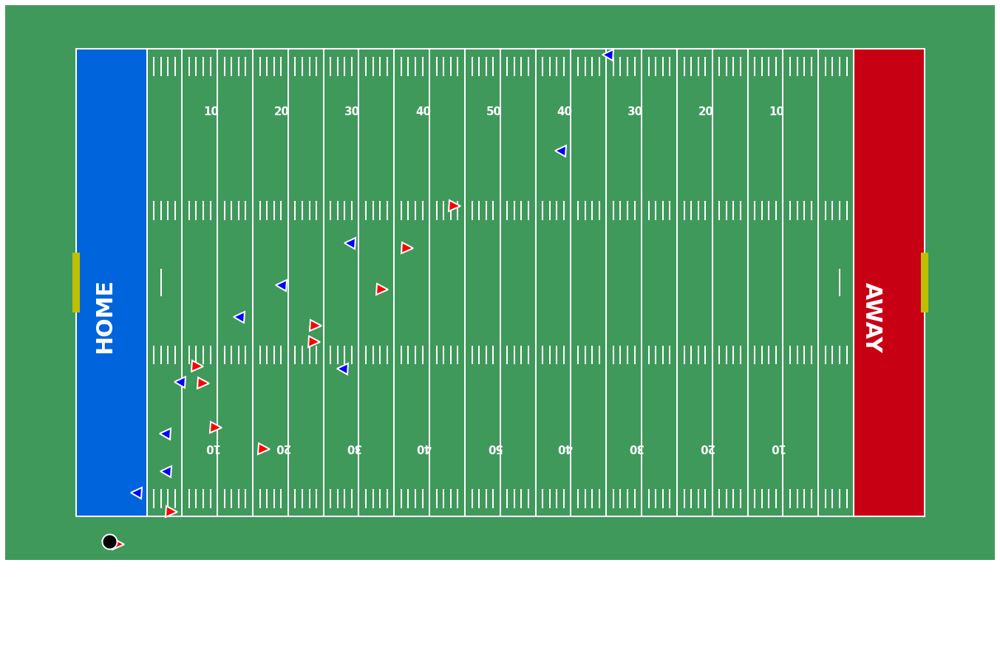

In [52]:
animate_one_play(2018091610, 3871, tracking2018)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.6 Random Play animation 5</span>

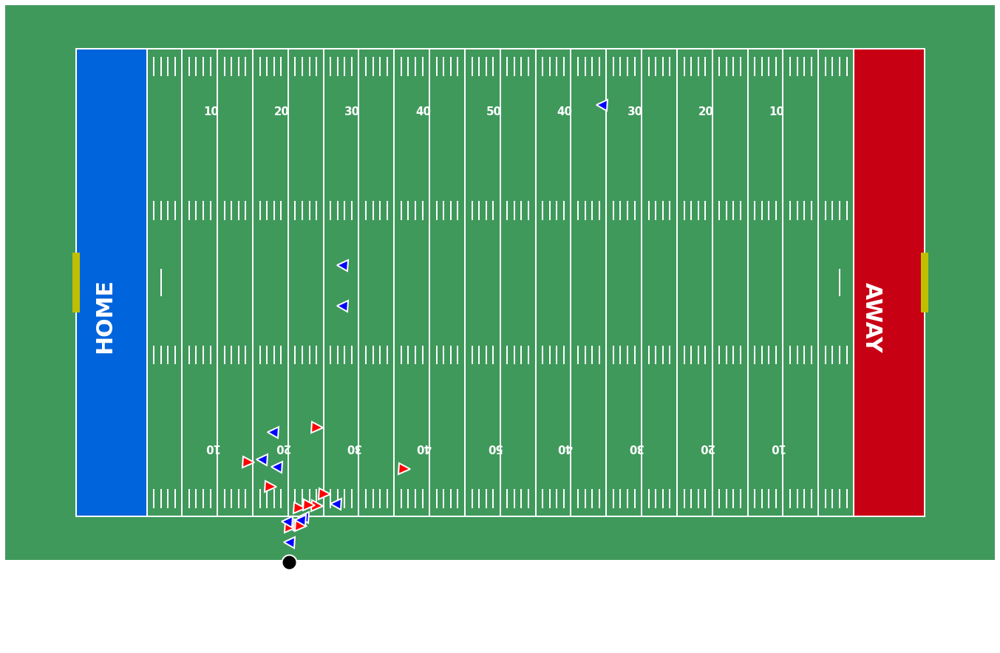

In [53]:
animate_one_play(2018110401, 2180, tracking2018)



## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">That's all folks! More will come later. Keep checking and keep learning</span>

![More to come](https://www.lambdatest.com/blog/wp-content/uploads/2019/11/giphy-2.gif)